# Problem Description :<a class="anchor" id="Problem"></a>
  - **Description** : </br>
    our mission here is to develope an automated tool that will predict 3d vulome shape tumor and this task called ***Segemntation*** , instead we will Re-Design model UnetPluePlus and improve Spatial information extracttion between layers Convolution to archive this process will need to add another mechanism Attention for each Encoder-UpSampling stages </br>
    
  - **Data informations**  
    the data used in this Project paper in this linke [cited](https://www.med.upenn.edu/cbica/brats2020/data.html) for short infos about , 
    All BraTS multimodal scans are available as NIfTI files (.nii.gz) and     describe as follow : 
    1. native (T1)  
    2. post-contrast T1-weighted (T1Gd), 
    3. T2-weighted (T2), 
    4. T2 Fluid Attenuated Inversion Recovery (T2-FLAIR) volumes.
    - **Annotations comprise:** </br>
        * the GD-enhancing tumor (ET),
        * the peritumoral edema (ED) 
        * the necrotic and non-enhancing tumor core (NCR/NET — TC).
        - **Notation** :</br>
            The possible classes are TC (Tumor core), WT (Whole tumor)
            and ET (Enhancing tumor)
    - **Formulation of the problem:**</br>
         Each pixel must be labeled “1” if it is part of one of the classes (NCR/NET — label 1, ED — label 2, ET — label 4), and “0” if not.




In [1]:
%%capture
!pip install albumentations==0.4.6
!pip install pydicom
!pip install nilearn
!pip install pynrrd
!pip install torchio
!pip install -U kaleido

In [2]:
#%matplotlib inline
import time
import tqdm
import os
import argparse
import logging
import sys
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb


import nibabel as nib
import torchio as tio
import tempfile

import sklearn 
from sklearn.model_selection import StratifiedKFold
import seaborn as sns
import imageio
from skimage.transform import resize
from skimage.util import montage
import matplotlib.patches as patches
from tqdm.notebook import tqdm
from IPython.display import Image as displayImage
from matplotlib.animation import FuncAnimation


from tqdm import tqdm
import os
import time
from random import randint

import numpy as np
from scipy import stats
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.model_selection import KFold

import nilearn as nl
import nrrd
import h5py

import nilearn.plotting as nlplt
import h5py

from matplotlib import cm
import matplotlib.animation as anim
from matplotlib.animation import FuncAnimation, PillowWriter 
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec

#import seaborn as sns
from IPython.display import Image as show_gif
from IPython.display import clear_output

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.nn import MSELoss
from torch.nn.functional import pad, sigmoid, binary_cross_entropy

from IPython.display import Image as show_gif


import warnings
warnings.simplefilter("ignore")


### Data Explorations and Processing <a class="anchor" id="Processing"></a>
 * the data we will use isn't stable yet whihc means is contain few issues need to handle are :
1. **Cleaning** : we will reformat the file sample CSV and save new file **Train_data.csv** that has all the information about each Patient to easy load the ID Patient modalities and read Images 
2. **Augmentation** :
   * Resize the Image 3D to reduce number of PIXELs to speed the loading data, the current size of image is  ***[ z = slices , x= width, y= hwight ]*** : 
       * img shape : (240, 240, 155)
       * mask shape : (240, 240, 155)
   * Resampling : This is a powerful transform that can be used to change the image shape or spatial metadata, or to apply a spatial transformation.
   * Transformation Operation : we will apply some transformation on data to Scale the image to improve the data 
<div class="alert alert-success" role="alert">
    Notations : the Augmentation task was done by using <strong><a href="https://torchio.readthedocs.io/">TorchIO package </a></strong>
</div>   


In [3]:
sample_filename = '../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_flair.nii'
sample_filename_mask = '../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_seg.nii'
sample_img = nib.load(sample_filename)
sample_img = np.asanyarray(sample_img.dataobj)
sample_mask = nib.load(sample_filename_mask)
sample_mask = np.asanyarray(sample_mask.dataobj)
print("img shape ->", sample_img.shape)
print("mask shape ->", sample_mask.shape)


img shape -> (240, 240, 155)
mask shape -> (240, 240, 155)


#### loading data and Virtualization <a class="anchor" id="Processing"></a>
* the Neuronscience community has been developed many tools to process data relate to study of Brain diseaes , here we will use two widely used packages to  handle our task are : 
<div class="alert alert-success" role="alert">
    packages : loading samples and virtualize : 
    <ul>
  <li><strong><a href="https://nipy.org/nibabel/">Nibable reading images </a></strong></li>
       <li><strong><a href="https://nilearn.github.io/stable/index.html">nilearn virualize images  </a></strong> </li>
    </ul>
</div> 



In [4]:
# niimg = nl.image.load_img(sample_filename)
# nimask = nl.image.load_img(sample_filename_mask)

# fig, axes = plt.subplots(nrows=4, figsize=(20, 30))


# nlplt.plot_anat(niimg,
#                 title='BraTS20_Training_001_flair.nii plot_anat',
#                 axes=axes[0])

# nlplt.plot_epi(niimg,
#                title='BraTS20_Training_001_flair.nii plot_epi',
#                axes=axes[1])

# nlplt.plot_img(niimg,
#                title='BraTS20_Training_001_flair.nii plot_img',
#                axes=axes[2])

# nlplt.plot_roi(nimask, 
#                title='BraTS20_Training_001_flair.nii with mask plot_roi',
#                bg_img=niimg, 
#                axes=axes[3], cmap='Paired')

# plt.show()



### data Cleanng : <a class="amchor" id="Cleanng"></a>
we will merge the data file cvs into one single file which has 
* Full path Patient ID 
* Spliting dataset into **Train** and **Validation** , **testing** using <a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedKFold.html">**StratifiedKFold**</a>

In [5]:
"""
Create class function for target path and seed random
"""
class GlobalConfig():
    root = '../input/brats20-dataset-training-validation/'
    train_path = 'BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/'
    val_path = 'BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/'
    name_mapping_path = 'name_mapping.csv'
    survival_info_path = 'survival_info.csv'
    path_to_csv = './train_data.csv'
    pretrained_model_path = '../input/brats20logs/brats2020logs/unetPlusAttetion/last_epoch_model.pth'
    train_logs_path = '../input/brats20logs/brats2020logs/unet/train_log.csv'
    seed = 55
def SeedEveryThing(seed:int):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
config = GlobalConfig()
SeedEveryThing(config.seed)

In [6]:
"""
In this dataset of MICCAI_BraTS2020, it has two data files CSV so we need to
merge them into one data frame to visualize and remove null data 
"""
### read the file csv data 
name_mapping = pd.read_csv(os.path.join(config.root, config.train_path + config.name_mapping_path))
survival_info = pd.read_csv(os.path.join(config.root, config.train_path + config.survival_info_path))
name_mapping.head(2)

,Grade,BraTS_2017_subject_ID,BraTS_2018_subject_ID,TCGA_TCIA_subject_ID,BraTS_2019_subject_ID,BraTS_2020_subject_ID
0,HGG,Brats17_CBICA_AAB_1,Brats18_CBICA_AAB_1,NaN,BraTS19_CBICA_AAB_1,BraTS20_Training_001
1,HGG,Brats17_CBICA_AAG_1,Brats18_CBICA_AAG_1,NaN,BraTS19_CBICA_AAG_1,BraTS20_Training_002


In [7]:
name_mapping.rename({'BraTS_2020_subject_ID': 'Brats20ID'}, axis = 1, inplace = True)
df = survival_info.merge(name_mapping, on='Brats20ID', how='right')
df.head(3)

,Brats20ID,Age,Survival_days,Extent_of_Resection,Grade,BraTS_2017_subject_ID,BraTS_2018_subject_ID,TCGA_TCIA_subject_ID,BraTS_2019_subject_ID
0,BraTS20_Training_001,60.463,289,GTR,HGG,Brats17_CBICA_AAB_1,Brats18_CBICA_AAB_1,NaN,BraTS19_CBICA_AAB_1
1,BraTS20_Training_002,52.263,616,GTR,HGG,Brats17_CBICA_AAG_1,Brats18_CBICA_AAG_1,NaN,BraTS19_CBICA_AAG_1
2,BraTS20_Training_003,54.301,464,GTR,HGG,Brats17_CBICA_AAL_1,Brats18_CBICA_AAL_1,NaN,BraTS19_CBICA_AAL_1


In [8]:
path = []
for _, row in df.iterrows():
    id_ = row['Brats20ID']
    phase = id_.split('_')[-2]
    if phase == 'Training':
        data_path = os.path.join(config.root, config.train_path + id_)
    else:
        data_path = os.path.join(config.root, config.train_path + id_)
    path.append(data_path)
path[:2]    

['../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001',
 '../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002']

In [9]:
df['Path'] = path
df['Age_rank'] = df['Age'].values//10*10
df= df.loc[df['Brats20ID'] != 'BraTS20_Training_355'].reset_index(drop = True)
train_df = df.loc[df['Age'].isnull() != True].reset_index(drop = True)
skf = StratifiedKFold(n_splits=7, random_state=config.seed, shuffle = True)


In [10]:
for i, (train_index, val_index) in enumerate(skf.split(train_df, train_df['Age_rank'])):
    train_df.loc[val_index,['Fold']] = i
train_data = train_df.loc[train_df['Fold'] != 0.0].reset_index(drop=True)
val_data = train_df.loc[train_df['Fold'] == 0.0].reset_index(drop=True)
test_df = df.loc[df['Age'].isnull()].reset_index(drop=True)
print("train_data ->", train_data.shape, "val_df ->", val_data.shape, "test_df ->", test_df.shape)
train_df.to_csv(config.path_to_csv, index = False)
train_data.head(3)

train_data -> (201, 12) val_df -> (34, 12) test_df -> (133, 11)


,Brats20ID,Age,Survival_days,Extent_of_Resection,Grade,BraTS_2017_subject_ID,BraTS_2018_subject_ID,TCGA_TCIA_subject_ID,BraTS_2019_subject_ID,Path,Age_rank,Fold
0,BraTS20_Training_001,60.463,289,GTR,HGG,Brats17_CBICA_AAB_1,Brats18_CBICA_AAB_1,NaN,BraTS19_CBICA_AAB_1,../input/brats20-dataset-training-validation/B...,60.0,1.0
1,BraTS20_Training_002,52.263,616,GTR,HGG,Brats17_CBICA_AAG_1,Brats18_CBICA_AAG_1,NaN,BraTS19_CBICA_AAG_1,../input/brats20-dataset-training-validation/B...,50.0,3.0
2,BraTS20_Training_004,39.068,788,GTR,HGG,Brats17_CBICA_AAP_1,Brats18_CBICA_AAP_1,NaN,BraTS19_CBICA_AAP_1,../input/brats20-dataset-training-validation/B...,30.0,3.0


### Transformation and DataLoader Class :<a class="anchor" id="DataLoader"></a> 
* at this stage we will explore most important step Per-Processing Data : to apply thses Transormation we will use Built methods from **TorchIO packages** 
    1. Transformation and Dataset Class: 
      - we need to extract the Id patient which has all the full modelities types corrsponding to Seg_in to convert Seg_in into **mulitChannlesLabels** </br> we will return **Y=label channel , X=Image**  
           * label 1 is the peritumoral edema
           * label 2 is the GD-enhancing tumor
           * label 3 is the necrotic and non-enhancing tumor core
           
    2. Build Dataset Class loader :
      - in Data Spliting there's **Fold** Column set Fold=0 which allow to take size shape Training and Valiadtion n_samples , Features , in this Step we will set **Phase** Train or Validation for training the model and batch_size=0 and num_worker=0 for Dataloaer Torch class and num_Workers=4 for TorchIO to speed Transformations Subject Lists 
       
       
       

In [11]:
# List transform
def get_agumentation(phase):
    if phase == 'train':
        # As RandomAffine is faster then RandomElasticDeformation, we choose to
        # apply RandomAffine 80% of the times and RandomElasticDeformation the rest
        # Also, there is a 25% chance that none of them will be applied
        list_transforms = [
#             tio.RandomAffine(p = 0.25),
#             tio.RandomFlip(axes=['LR', 'AP', 'IS'], p = 0.02),
            tio.Resize((50,50,50)),
            tio.RandomBiasField(p = 0.25),
            tio.RandomBlur(p = 0.25),
#             tio.RandomNoise(p = 0.25),
            tio.RescaleIntensity(out_min_max=(0, 1)),
            
        ]
        # Transforms can be composed as in torchvision.transforms
        transform = tio.Compose(list_transforms)
    else:
        list_transforms = [
#                        tio.Resize((50,50,50)),
                        tio.RescaleIntensity(out_min_max=(0, 1)),
            
        ]
        transform = tio.Compose(list_transforms)
    return transform

In [12]:
class BratsDataSet(Dataset):
    def __init__(self, df: pd.DataFrame, phase: str = 'test'):
        self.df = df
        self.phase = phase
        self.data_types = ['_flair.nii', '_t1.nii', '_t1ce.nii', '_t2.nii']
    def __len__(self):
        return self.df.shape[0]
    def __getitem__(self, index):
        id_ = self.df.loc[index, 'Brats20ID']
        data_path = self.df.loc[self.df['Brats20ID'] == id_]['Path'].values[0]
        data_img = []
        resample = tio.Resample((2,2,2))
        for data_type in self.data_types:
            img = tio.ScalarImage(os.path.join(data_path, id_ + data_type)) #data_img shape (1, 240, 240, 155)
            img = resample(img) #data_img shape (1, 120, 120, 78)
            img = np.array(img)
            img = np.squeeze(img, axis = 0)
            img = self.Normalize(img)
            data_img.append(img)
        img_stack = np.stack(data_img)
        img_stack = np.moveaxis(img_stack, (0,1,2,3), (0,3,2,1))
        img_stack = torch.Tensor(img_stack)
        
        if self.phase != 'test':
            labels = tio.LabelMap(os.path.join(data_path, id_ + '_seg.nii'))
            labels = resample(labels)
            labels = np.array(labels)
            labels = np.squeeze(labels, axis = 0)
            label_stack = self.ConvertToMultiChannel(labels)
            label_stack = torch.Tensor(label_stack)
            
            subjects = tio.Subject(image = tio.ScalarImage(tensor = img_stack),
                                   label = tio.LabelMap(tensor = (label_stack > 0.5)),
                                   id = id_
                                  )
            
            
            return subjects
        subjects = tio.Subject(image = tio.ScalarImage(tensor = img_stack),
                               id = id_
                              )
        return subjects
    
    def Normalize(self, image : np.ndarray):
        return (image - np.min(image))/(np.max(image) - np.min(image))
 
    def ConvertToMultiChannel(self, labels):
        '''
        Convert labels to multi channels based on brats classes:
        label 1 is the peritumoral edema
        label 2 is the GD-enhancing tumor
        label 3 is the necrotic and non-enhancing tumor core
        The possible classes are TC (Tumor core), WT (Whole tumor)
        and ET (Enhancing tumor)
        '''
        label_TC = labels.copy()
        label_TC[label_TC == 1] = 1
        label_TC[label_TC == 2] = 0
        label_TC[label_TC == 4] = 1
        
        
        label_WT = labels.copy()
        label_WT[label_WT == 1] = 1
        label_WT[label_WT == 2] = 1
        label_WT[label_WT == 4] = 1
        
        label_ET = labels.copy()
        label_ET[label_ET == 1] = 0
        label_ET[label_ET == 2] = 0
        label_ET[label_ET == 4] = 1
        
        label_stack = np.stack([label_WT, label_TC, label_ET])
        label_stack = np.moveaxis(label_stack, (0,1,2,3), (0,3,2,1))
        return label_stack
        

In [13]:
def get_dataloader(dataset, path_to_csv, phase, fold = 0, batch_size = 1, num_workers = 4):
    """
    This  function is saving image data in to the list and putting it with torchio.SubjectDataSet
    to split and transform image
    """
    start_time = time.time()
    data = pd.read_csv(path_to_csv)
    train_data = data.loc[data['Fold'] != fold].reset_index(drop = True)
    val_data = data.loc[data['Fold'] == fold].reset_index(drop = True)
    if phase == 'train':
        data = train_data
    else:
        data = val_data 
    data_set = dataset(data, phase)
    list_subjects = []
    for i in range(len(data_set)):
        list_subjects.append(data_set[i])
    subject_dataset = tio.SubjectsDataset(list_subjects, transform=get_agumentation(phase))
    patch_size = 50
    queue_length = 300
    sample_per_volume = 1
    sampler = tio.data.UniformSampler(patch_size)
    patches_queue = tio.Queue(
        subject_dataset,
        queue_length,
        sample_per_volume,
        sampler,
        num_workers=num_workers,
    )
    data_loader = DataLoader(subject_dataset,
                             batch_size = batch_size,
                             num_workers=0,
                             pin_memory=True,
                            )
    return data_loader

In [14]:
dataloader = get_dataloader(dataset=BratsDataSet, path_to_csv='train_data.csv', phase='valid', fold=0)
len(dataloader)

34

In [15]:
data = next(iter(dataloader))
data['id'], data['image'][tio.DATA].shape, data['label'][tio.DATA].shape

(['BraTS20_Training_003'],
 torch.Size([1, 4, 78, 120, 120]),
 torch.Size([1, 3, 78, 120, 120]))

Num uniq Image values : 349
Min/Max Image values: 0.0 1.0
Num uniq Mask values: (array([0, 1], dtype=uint8), array([1122735,     465]))


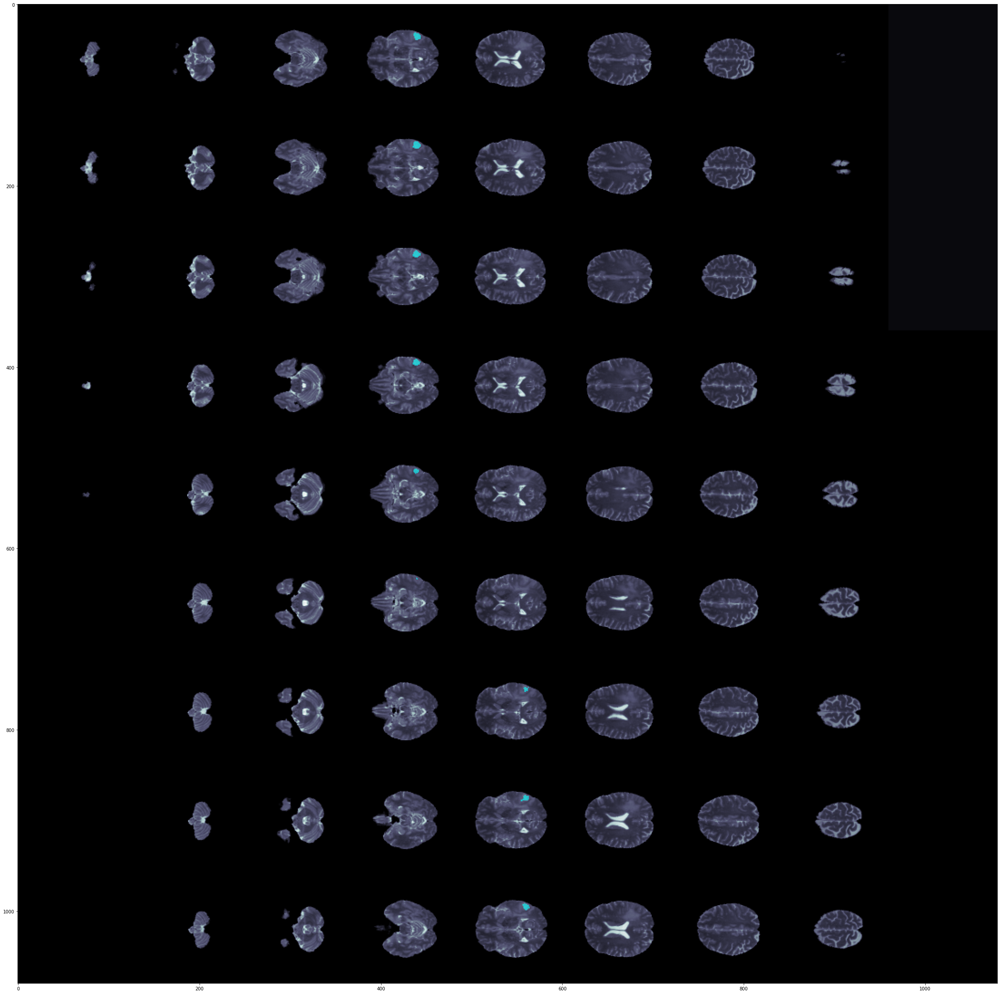

In [16]:
img_tensor = data['image'][tio.DATA].squeeze()[3].cpu().detach().numpy() 
mask_tensor = data['label'][tio.DATA].squeeze()[1].squeeze().cpu().detach().numpy()

print("Num uniq Image values :", len(np.unique(img_tensor, return_counts=True)[0]))
print("Min/Max Image values:", img_tensor.min(), img_tensor.max())
print("Num uniq Mask values:", np.unique(mask_tensor, return_counts=True))

image = np.rot90(montage(img_tensor))
mask = np.rot90(montage(mask_tensor)) 

fig, ax = plt.subplots(1, 1, figsize = (60, 40))
ax.imshow(image, cmap ='bone')
ax.imshow(np.ma.masked_where(mask == False, mask),
           cmap='cool', alpha=0.6)

### metrics  Measurements  Performance for segmentation task model <a class="anchor" id="Measurements"></a>
* There are many metrics that can be used to measure the performance of a model for a segmentation task, including:
    1. **Dice coefficient:** This metric measures the overlap between the predicted segmentation and the ground truth segmentation. It is calculated as the ratio of the intersection of the predicted and ground truth segmentations to the union of the two. The Dice coefficient ranges from 0 (no overlap) to 1 (perfect overlap).

    2. **Intersection over Union (IoU):** This metric is also known as the Jaccard index, and it is calculated as the ratio of the intersection of the predicted and ground truth segmentations to the union of the two.

    3. **Sensitivity:** This metric measures the proportion of positive instances (e.g., pixels belonging to the object of interest) in the ground truth segmentation that are correctly predicted by the model. It is calculated as the number of true positives divided by the total number of positive instances in the ground truth.

    4. **Specificity:** This metric measures the proportion of negative instances (e.g., pixels not belonging to the object of interest) in the ground truth segmentation that are correctly predicted by the model. It is calculated as the number of true negatives divided by the total number of negative instances in the ground truth.

    4. **Accuracy:** This metric measures the overall accuracy of the model's predictions, including both positive and negative instances. It is calculated as the number of correct predictions divided by the total number of predictions.

    6. **F1 score:** This metric is the harmonic mean of sensitivity and specificity, and it is often used as a summary measure of a model's performance.

    7. **Mean Squared Error (MSE):** This metric measures the average squared difference between the predicted and ground truth segmentations. It is often used to evaluate the quality of a model's predictions.

    8. **Mean Absolute Error (MAE):** This metric measures the average absolute difference between the predicted and ground truth segmentations. It is often used as a robust measure of a model's performance, as it is less sensitive to outliers than the MSE.

    9. **Hausdorff distance:** This metric measures the maximum distance between the predicted and ground truth segmentations. It is often used to evaluate the precision of a model's predictions.
    
    10. **Jaccard index:** This metric is similar to the Dice coefficient, but it is calculated as the ratio of the intersection of the predicted and ground truth segmentations to the size of the predicted segmentation.
<div class="alert alert-warning" role="alert">
    Notations : for our Project we will use BCELoss and Dicecoef and Jacoard index  <strong><a href="https://ilmonteux.github.io/2019/05/10/segmentation-metrics.html">metrcies meaurments </a></strong>
</div>  


In [17]:
def dice_coef_metric(probabilities: torch.Tensor,
                     truth: torch.Tensor,
                     treshold: float = 0.5,
                     eps: float = 1e-9) -> np.ndarray:
    """
    Calculate Dice score for data batch.
    Params:
        probobilities: model outputs after activation function.
        truth: truth values.
        threshold: threshold for probabilities.
        eps: additive to refine the estimate.
        Returns: dice score aka f1.
    """
    scores = []
    num = probabilities.shape[0]
    predictions = (probabilities >= treshold).float()
    assert(predictions.shape == truth.shape)
    for i in range(num):
        prediction = predictions[i]
        truth_ = truth[i]
        intersection = 2.0 * (truth_ * prediction).sum()
        union = truth_.sum() + prediction.sum()
        if truth_.sum() == 0 and prediction.sum() == 0:
            scores.append(1.0)
        else:
            scores.append((intersection + eps) / union)
    return np.mean(scores)


def jaccard_coef_metric(probabilities: torch.Tensor,
               truth: torch.Tensor,
               treshold: float = 0.5,
               eps: float = 1e-9) -> np.ndarray:
    """
    Calculate Jaccard index for data batch.
    Params:
        probobilities: model outputs after activation function.
        truth: truth values.
        threshold: threshold for probabilities.
        eps: additive to refine the estimate.
        Returns: jaccard score aka iou."
    """
    scores = []
    num = probabilities.shape[0]
    predictions = (probabilities >= treshold).float()
    assert(predictions.shape == truth.shape)

    for i in range(num):
        prediction = predictions[i]
        truth_ = truth[i]
        intersection = (prediction * truth_).sum()
        union = (prediction.sum() + truth_.sum()) - intersection + eps
        if truth_.sum() == 0 and prediction.sum() == 0:
            scores.append(1.0)
        else:
            scores.append((intersection + eps) / union)
    return np.mean(scores)


class Meter:
    '''factory for storing and updating iou and dice scores.'''
    def __init__(self, treshold: float = 0.5):
        self.threshold: float = treshold
        self.dice_scores: list = []
        self.iou_scores: list = []
    
    def update(self, logits: torch.Tensor, targets: torch.Tensor):
        """
        Takes: logits from output model and targets,
        calculates dice and iou scores, and stores them in lists.
        """
        probs = torch.sigmoid(logits)
        dice = dice_coef_metric(probs, targets, self.threshold)
        iou = jaccard_coef_metric(probs, targets, self.threshold)
        
        self.dice_scores.append(dice)
        self.iou_scores.append(iou)
    
    def get_metrics(self) -> np.ndarray:
        """
        Returns: the average of the accumulated dice and iou scores.
        """
        dice = np.mean(self.dice_scores)
        iou = np.mean(self.iou_scores)
        return dice, iou
    
# helper functions for testing.  
def dice_coef_metric_per_classes(probabilities: np.ndarray,
                                    truth: np.ndarray,
                                    treshold: float = 0.5,
                                    eps: float = 1e-9,
                                    classes: list = ['WT', 'TC', 'ET']) -> np.ndarray:
    """
    Calculate Dice score for data batch and for each class.
    Params:
        probobilities: model outputs after activation function.
        truth: model targets.
        threshold: threshold for probabilities.
        eps: additive to refine the estimate.
        classes: list with name classes.
        Returns: dict with dice scores for each class.
    """
    scores = {key: list() for key in classes}
    num = probabilities.shape[0]
    num_classes = probabilities.shape[1]
    predictions = (probabilities >= treshold).astype(np.float32)
    assert(predictions.shape == truth.shape)

    for i in range(num):
        for class_ in range(num_classes):
            prediction = predictions[i][class_]
            truth_ = truth[i][class_]
            intersection = 2.0 * (truth_ * prediction).sum()
            union = truth_.sum() + prediction.sum()
            if truth_.sum() == 0 and prediction.sum() == 0:
                 scores[classes[class_]].append(1.0)
            else:
                scores[classes[class_]].append((intersection + eps) / union)
                
    return scores


def jaccard_coef_metric_per_classes(probabilities: np.ndarray,
               truth: np.ndarray,
               treshold: float = 0.5,
               eps: float = 1e-9,
               classes: list = ['WT', 'TC', 'ET']) -> np.ndarray:
    """
    Calculate Jaccard index for data batch and for each class.
    Params:
        probobilities: model outputs after activation function.
        truth: model targets.
        threshold: threshold for probabilities.
        eps: additive to refine the estimate.
        classes: list with name classes.
        Returns: dict with jaccard scores for each class."
    """
    scores = {key: list() for key in classes}
    num = probabilities.shape[0]
    num_classes = probabilities.shape[1]
    predictions = (probabilities >= treshold).astype(np.float32)
    assert(predictions.shape == truth.shape)

    for i in range(num):
        for class_ in range(num_classes):
            prediction = predictions[i][class_]
            truth_ = truth[i][class_]
            intersection = (prediction * truth_).sum()
            union = (prediction.sum() + truth_.sum()) - intersection + eps
            if truth_.sum() == 0 and prediction.sum() == 0:
                 scores[classes[class_]].append(1.0)
            else:
                scores[classes[class_]].append((intersection + eps) / union)

    return scores

class Scores:
    def __init__(self, threshold: float=0.5):
        self.threshold = threshold
        self.dice_scores: list = []
        self.iou_scores: list = []
    def update(self, logits: torch.Tensor, target: torch.Tensor):
        inputs = torch.sigmoid(logits)
        dice = dice_coef_metric(inputs, target, self.threshold)
        iou = jaccard_coef_metric(inputs, target, self.threshold)
        
        self.dice_scores.append(dice)
        self.iou_scores.append(iou)
    def get_metrics(self):
        dice = np.mean(self.dice_scores)
        iou = np.mean(self.iou_scores)
        return dice, iou

In [18]:
def jaccard_coef_metric(inputs: torch.Tensor, target: torch.Tensor, threshold: float = 0.5, eps: float = 1e-9):
    scores = []
    num = inputs.shape[0]
    predictions = (inputs >= threshold).float()
    assert(predictions.shape == target.shape)
    for i in range(num):
        prediction = predictions[i]
        target_ = target[i]
        intersection = (prediction * target_).sum()
        union = (prediction.sum() + target_.sum()) - (intersection + eps)
        
        if target_.sum() == 0 and prediction.sum() == 0:
            scores.append(1.0)
        else:
            scores.append((intersection + eps)/union)
    return np.mean(scores)

In [19]:
class DiceLoss(nn.Module):
    def __init__(self, weight = None, size_average = True):
        super(DiceLoss, self).__init__()
    def forward(self, inputs, targets, smooth = 1):
        # Commnent out if your model contains a sigmoid or equivalent activation layer
        inputs = sigmoid(inputs)
        
        # Flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs*targets).sum()
        dice = (2.*intersection + smooth)/(inputs.sum()+ targets.sum() + smooth)
        return 1 - dice



In [20]:
def dice_coef_metric(inputs: torch.Tensor, target: torch.Tensor, threshold: float = 0.5, eps:float = 1e-9) -> np.ndarray:
    """
    Calculate Dice score for data batch,
    Params:
        inputs: model outputs after activation function
        target: true values
        threshold: threshold for inputs
        eps: additive to refine the estimate
    Return: dice score 
    """
    score = []
    num = inputs.shape[0]
    predictions = (inputs >= threshold).float()
    assert(predictions.shape == target.shape)
    for i in range(num):
        predict = predictions[i]
        target_ = target[i]
        intersection = 2.0*(target_*predict).sum()
        union = target_.sum() + predict.sum()
        if target_.sum() == 0 and predict.sum() == 0:
            score.append(1.0)
        else:
            score.append((intersection + eps)/union)
    return np.mean(score)

In [21]:
def dice_coef_metric_class(inputs, targets, threshold=0.5, eps:float=1e-9,classes = ['WT, TC', 'ET']):
    """ calculate dice scores for each class"""
    scores = {key:list for key in classes}
    num = inputs.shape[0]
    num_classes = inputs.shape[1]
    predictions = (inputs>=threshold).astype(np.float32)
    assert(prediction.shape == target.shape)
    for i in range(num):
        for class_ in classes:
            prediction = predictions[i][class_]
            target_ = target[i][class_]
            intersection = 2.0 * (prediction * prediction).sum()
            union = target_.sum() + prediction.sum()
            if target.sum() == 0 and prediction.sum() == 0:
                scores[classes][class_].append(1.0)
            else:
                scores[classes][class_].append((intersection+eps)/(union))
    return scores

### **BCE-Dice Loss**
   - This loss combines Dice loss with the standard binary cross-entropy (BCE) loss that is generally the default for segmentation models. Combining the two methods allows for some diversity in the loss, while benefitting from the stability of BCE. The equation for multi-class BCE by itself will be familiar to anyone who has studied logistic regression:   

In [22]:
class DiceLoss(nn.Module):
    """Calculate dice loss."""
    def __init__(self, eps: float = 1e-9):
        super(DiceLoss, self).__init__()
        self.eps = eps
        
    def forward(self,
                logits: torch.Tensor,
                targets: torch.Tensor) -> torch.Tensor:
        
        num = targets.size(0)
        probability = torch.sigmoid(logits)
        probability = probability.view(num, -1)
        targets = targets.view(num, -1)
        assert(probability.shape == targets.shape)
        
        intersection = 2.0 * (probability * targets).sum()
        union = probability.sum() + targets.sum()
        dice_score = (intersection + self.eps) / union
        #print("intersection", intersection, union, dice_score)
        return 1.0 - dice_score
        
        
class BCEDiceLoss(nn.Module):
    """Compute objective loss: BCE loss + DICE loss."""
    def __init__(self):
        super(BCEDiceLoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
        self.dice = DiceLoss()
        
    def forward(self, 
                logits: torch.Tensor,
                targets: torch.Tensor) -> torch.Tensor:
        assert(logits.shape == targets.shape)
        dice_loss = self.dice(logits, targets)
        bce_loss = self.bce(logits, targets)
        
        return bce_loss + dice_loss

class IoU(nn.Module):
    def __init__(self, weight = None, size_average = True):
        super(IoU, self).__init__()
    def forward(self, inputs, target, smooth = 1):
        inputs = sigmoid(inputs)
        
        # Flatten labels and predict
        inputs = inputs.view(-1)
        target = target.view(-1)
        
        interection = (inputs*target).sum()
        total = (inputs + target).sum()
        union = total - interection
        
        IoU = (interection + smooth)/ (union + smooth)
        return 1 - IoU

In [23]:
class Scores:
    def __init__(self, threshold: float=0.5):
        self.threshold = threshold
        self.dice_scores: list = []
        self.iou_scores: list = []
    def update(self, logits: torch.Tensor, target: torch.Tensor):
        inputs = torch.sigmoid(logits)
        dice = dice_coef_metric(inputs, target, self.threshold)
        iou = jaccard_coef_metric(inputs, target, self.threshold)
        
        self.dice_scores.append(dice)
        self.iou_scores.append(iou)
    def get_metrics(self):
        dice = np.mean(self.dice_scores)
        iou = np.mean(self.iou_scores)
        return dice, iou

### **Focal Loss**
- Focal Loss was introduced by Lin et al of Facebook AI Research in 2017 as a means of combatting extremely imbalanced datasets where positive cases were relatively rare. Their paper "Focal Loss for Dense Object Detection" is retrievable here: https://arxiv.org/abs/1708.02002. In practice, the researchers used an alpha-modified version of the function so I have included it in this implementation.

In [24]:
class FocalLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(FocalLoss, self).__init__()

    def forward(self, inputs, targets, alpha=0.8, gamma=2, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #first compute binary cross-entropy 
        BCE = F.binary_cross_entropy(inputs, targets, reduction='mean')
        BCE_EXP = torch.exp(-BCE)
        focal_loss = alpha * (1-BCE_EXP)**gamma * BCE
                       
        return focal_loss

### **Tversky Loss**

- This loss was introduced in "Tversky loss function for image segmentationusing 3D fully convolutional deep networks", retrievable here: https://arxiv.org/abs/1706.05721. It was designed to optimise segmentation on imbalanced medical datasets by utilising constants that can adjust how harshly different types of error are penalised in the loss function. From the paper:

- ... in the case of α=β=0.5 the Tversky index simplifies to be the same as the Dice coefficient, which is also equal to the F1 score. With α=β=1, Equation 2 produces Tanimoto coefficient, and setting α+β=1 produces the set of Fβ scores. Larger βs weigh recall higher than precision (by placing more emphasis on false negatives).

- To summarise, this loss function is weighted by the constants 'alpha' and 'beta' that penalise false positives and false negatives respectively to a higher degree in the loss function as their value is increased. The beta constant in particular has applications in situations where models can obtain misleadingly positive performance via highly conservative prediction. You may want to experiment with different values to find the optimum. With alpha==beta==0.5, this loss becomes equivalent to Dice Loss.

In [25]:
class TverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(TverskyLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1, alpha=0.5, beta=0.5):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
       
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        
        return 1 - Tversky

### **Focal Tversky Loss**

A variant on the Tversky loss that also includes the gamma modifier from Focal Loss.

In [26]:
class FocalTverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(FocalTverskyLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1, alpha=0.7, beta=0.3, gamma=4/3):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
        
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        FocalTversky = (1 - Tversky)**gamma
                       
        return FocalTversky

### Build the model 3D Attention Unet++ <a class="anchor" id="Unet"></a>
* i will provide brefliy explainations about Attention **UnetPlusPlus** and **Attention gate** :
    * The Attention U-Net++ model is based on the U-Net architecture, which is a deep learning model commonly used for image segmentation tasks. The U-Net architecture consists of the following building blocks:

       - **Encoder**: The encoder consists of a series of convolutional and pooling layers that extract features from the input image. The output of each layer is passed through a non-linear activation function, such as ReLU, to introduce non-linearity into the model.

       - **Skip connections**: Skip connections are used to connect corresponding layers in the encoder and decoder. The skip connections allow the model to make use of both low-level and high-level features, which can improve the performance of the model for tasks such as image segmentation.

       - **Decoder**: The decoder consists of a series of convolutional and upsampling layers that combine the features extracted by the encoder with the skip connections to produce the final segmentation map.

       - **Attention mechanisms**: The Attention U-Net++ model builds on the U-Net architecture by adding attention mechanisms to the skip connections. Attention mechanisms are a type of neural network layer that allows the model to selectively focus on certain parts of the input, rather than processing the entire input equally. This can be particularly useful in image segmentation tasks, where the model may need to focus on specific regions or objects in the image.

<div class="alert alert-warning" role="alert">
    Notations : Paper i followd to build this model Reading important  <strong><a href="https://ieeexplore.ieee.org/document/9190761">Attention Unet++ </a></strong>
</div>  


In [27]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        x = self.double_conv(x)
        return x

In [28]:
class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.MaxPool3d(kernel_size=2, stride=2),
            DoubleConv(in_channels, out_channels)
        )
    def forward(self, x):
        x = self.encoder(x)
        return x

In [29]:
class Up(nn.Module):
    def __init__(self, in_channels, out_channels, trilinear=True):
        super().__init__()
        self.up = nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv = DoubleConv(in_channels, out_channels)
    def forward(self, x1, x2):
        x1 = self.up(x1)
        # Make sure size data when you combine are the same size
        diffX = x2.size()[4] - x1.size()[4]
        diffY = x2.size()[3] - x1.size()[3]
        diffZ = x2.size()[2] - x1.size()[2]
        
        x1 = torch.nn.functional.pad(x1, (diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2, diffZ // 2, diffZ - diffZ // 2))
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

In [30]:
class UpP(nn.Module):
    def __init__(self, in_channels, out_channels, trilinear=True):
        super().__init__()
        self.up = nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv = DoubleConv(out_channels*3, out_channels)
    def forward(self, x1, x2, x3):
        x1 = self.up(x1)
        # Make sure size data when you combine are the same size
        diffX1 = x3.size()[4] - x1.size()[4]
        diffY1 = x3.size()[3] - x1.size()[3]
        diffZ1 = x3.size()[2] - x1.size()[2]
        
        diffX2 = x3.size()[4] - x2.size()[4]
        diffY2 = x3.size()[3] - x2.size()[3]
        diffZ2 = x3.size()[2] - x2.size()[2]
        
        x2 = torch.nn.functional.pad(x2, (diffX2 // 2, diffX2 - diffX2 // 2, diffY2 // 2, diffY2 - diffY2 // 2, diffZ2 // 2, diffZ2 - diffZ2 // 2))
        x1 = torch.nn.functional.pad(x1, (diffX1 // 2, diffX1 - diffX1 // 2, diffY1 // 2, diffY1 - diffY1 // 2, diffZ1 // 2, diffZ1 - diffZ1 // 2))
        x = torch.cat([x3, x2, x1], dim=1)
        return self.conv(x)

In [31]:

class Out(nn.Module):
    def __init__(self, in_channels, out_channels,n_classes):
        super().__init__()
        self.out_conv = nn.Sequential(
        nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2),
        nn.BatchNorm3d(in_channels),
        nn.ReLU(inplace=True),
        nn.Conv3d(out_channels,n_classes, kernel_size=1)
        )
    def forward(self, x):
        return self.out_conv(x)



In [32]:
class Out_(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.out_conv = nn.Conv3d(in_channels, out_channels, kernel_size=1)
    def forward(self, x):
        return self.out_conv(x)

In [33]:
class UpPPP(nn.Module):
    def __init__(self, in_channels, out_channels, trilinear=True):
        super().__init__()
        self.up = nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv = DoubleConv(out_channels*5, out_channels)
    def forward(self, x1, x2, x3, x4, x5):
        x1 = self.up(x1)
        # Make sure size data when you combine are the same size
        diffX1 = x5.size()[4] - x1.size()[4]
        diffY1 = x5.size()[3] - x1.size()[3]
        diffZ1 = x5.size()[2] - x1.size()[2]
        
        diffX2 = x5.size()[4] - x2.size()[4]
        diffY2 = x5.size()[3] - x2.size()[3]
        diffZ2 = x5.size()[2] - x2.size()[2]
        
        diffX3 = x5.size()[4] - x3.size()[4]
        diffY3 = x5.size()[3] - x3.size()[3]
        diffZ3 = x5.size()[2] - x3.size()[2]
        
        diffX4 = x5.size()[4] - x4.size()[4]
        diffY4 = x5.size()[3] - x4.size()[3]
        diffZ4 = x5.size()[2] - x4.size()[2]
        
        x4 = torch.nn.functional.pad(x4, (diffX4 // 2, diffX4 - diffX4 // 2, diffY4 // 2, diffY4 - diffY4 // 2, diffZ4 // 2, diffZ4 - diffZ4 // 2))        
        x3 = torch.nn.functional.pad(x3, (diffX3 // 2, diffX3 - diffX3 // 2, diffY3 // 2, diffY3 - diffY3 // 2, diffZ3 // 2, diffZ3 - diffZ3 // 2))
        x2 = torch.nn.functional.pad(x2, (diffX2 // 2, diffX2 - diffX2 // 2, diffY2 // 2, diffY2 - diffY2 // 2, diffZ2 // 2, diffZ2 - diffZ2 // 2))
        x1 = torch.nn.functional.pad(x1, (diffX1 // 2, diffX1 - diffX1 // 2, diffY1 // 2, diffY1 - diffY1 // 2, diffZ1 // 2, diffZ1 - diffZ1 // 2))
        x = torch.cat([x5, x4, x3, x2, x1], dim=1)
        return self.conv(x)

In [34]:
class UpPP(nn.Module):
    def __init__(self, in_channels, out_channels, trilinear=True):
        super().__init__()
        self.up = nn.ConvTranspose3d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv = DoubleConv(out_channels*4, out_channels)
    def forward(self, x1, x2, x3, x4):
        x1 = self.up(x1)
        # Make sure size data when you combine are the same size
        diffX1 = x4.size()[4] - x1.size()[4]
        diffY1 = x4.size()[3] - x1.size()[3]
        diffZ1 = x4.size()[2] - x1.size()[2]
        
        diffX2 = x4.size()[4] - x2.size()[4]
        diffY2 = x4.size()[3] - x2.size()[3]
        diffZ2 = x4.size()[2] - x2.size()[2]
        
        diffX3 = x4.size()[4] - x3.size()[4]
        diffY3 = x4.size()[3] - x3.size()[3]
        diffZ3 = x4.size()[2] - x3.size()[2]
        
        x3 = torch.nn.functional.pad(x3, (diffX3 // 2, diffX3 - diffX3 // 2, diffY3 // 2, diffY3 - diffY3 // 2, diffZ3 // 2, diffZ3 - diffZ3 // 2))
        x2 = torch.nn.functional.pad(x2, (diffX2 // 2, diffX2 - diffX2 // 2, diffY2 // 2, diffY2 - diffY2 // 2, diffZ2 // 2, diffZ2 - diffZ2 // 2))
        x1 = torch.nn.functional.pad(x1, (diffX1 // 2, diffX1 - diffX1 // 2, diffY1 // 2, diffY1 - diffY1 // 2, diffZ1 // 2, diffZ1 - diffZ1 // 2))
        x = torch.cat([x4, x3, x2, x1], dim=1)
        return self.conv(x)

In [35]:
class AttentionBlock(nn.Module):
    '''
    stride = 2; please set --attention parameter to 1 when activate this block. the result name should include "att2".
    To fit in the structure of the V-net: F_l = F_int
    '''
    def __init__(self, F_g, F_l, F_int, scale_factor=1, mode="trilinear"):
        super(AttentionBlock, self).__init__()
        self.scale_factor = scale_factor
        self.mode = mode
        self.W_g = nn.Sequential(
            nn.Conv3d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),  # reduce num_channels
            nn.BatchNorm3d(F_int)
        )

        self.W_x = nn.Sequential(
            nn.Conv3d(F_l, F_int, kernel_size=scale_factor, stride=scale_factor, padding=0, bias=True),
            nn.BatchNorm3d(F_int)
        )

        self.psi = nn.Sequential(
            nn.Conv3d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm3d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x, visualize=False):
        '''
        :param g: gate signal from coarser scale
        :param x: the output of the l-th layer in the encoder
        :param visualize: enable this when plotting attention matrix
        :return:
        '''
        x1 = self.W_x(x)
        g1 = self.W_g(g)
        relu = self.relu(g1 + x1)
        sig = self.psi(relu)
        alpha = nn.functional.interpolate(sig, scale_factor=self.scale_factor, mode=self.mode)
        

        if visualize:
            return alpha
        else:
            return x * alpha

In [36]:
class UNET3DPP(nn.Module):
    def __init__(self, in_channels, out_channels, n_classes):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.n_classes = n_classes
        
        self.x00 = DoubleConv(self.in_channels, self.out_channels)
        # UNet3D ++ L1
        self.down_to_x10 = Down(self.out_channels, self.out_channels*2)
        self.up_to_x01 = Up(self.out_channels*2, self.out_channels)
        # UNet3D ++ L2
        self.down_to_x20 = Down(self.out_channels*2, self.out_channels*4)
        self.up_to_x11 = Up(self.out_channels*4, self.out_channels*2)
        self.up_to_x02 = UpP(self.out_channels*2, self.out_channels)
        # UNet3D ++ L3
        self.down_to_x30 = Down(self.out_channels*4, self.out_channels*8)
        self.up_to_x21 = Up(self.out_channels*8, self.out_channels*4)
        self.up_to_x12 = UpP(self.out_channels*4, self.out_channels*2)
        self.up_to_x03 = UpPP(self.out_channels*2, self.out_channels)
        # UNet3D ++ L4
        self.down_to_x40 = Down(self.out_channels*8, self.out_channels*16)
        self.up_to_x31 = Up(self.out_channels*16, self.out_channels*8)
        self.up_to_x22 = UpP(self.out_channels*8, self.out_channels*4)
        self.up_to_x13 = UpPP(self.out_channels*4, self.out_channels*2)
        self.up_to_x04 = UpPPP(self.out_channels*2, self.out_channels)
        
        # output
        self.out = Out_(self.out_channels, self.n_classes)
        
        self.dropout = nn.Dropout3d(0.25)
    def forward(self, x):
        x00 = self.x00(x)
        # UNet3D ++ L1
        x10 = self.down_to_x10(x00)
        x01 = self.up_to_x01(x10, x00)
        x01 = self.dropout(x01)
        # UNet3D ++ L2
        x20 = self.down_to_x20(x10)
        x11 = self.up_to_x11(x20, x10)
        x11 = self.dropout(x11)
        x02 = self.up_to_x02(x11, x01, x00)
        x02 = self.dropout(x02)
        # UNet3D ++ L3
        x30 = self.down_to_x30(x20)
        x21 = self.up_to_x21(x30, x20)
        x21 = self.dropout(x21)
        x12 = self.up_to_x12(x21, x11, x10)
        x12 = self.dropout(x12)
        x03 = self.up_to_x03(x12, x02, x01, x00)
        x03 = self.dropout(x03)
        # UNet3D ++ L4
        x40 = self.down_to_x40(x30)
        x31 = self.up_to_x31(x40, x30)
        x31 = self.dropout(x31)
        x22 = self.up_to_x22(x31, x21, x20)
        x22 = self.dropout(x22)
        x13 = self.up_to_x13(x22, x12, x11, x10)
        x13 = self.dropout(x13)
        x04 = self.up_to_x04(x13, x03, x02, x01, x00)
        x04 = self.dropout(x04)
        
        # Output
        out = self.out(x04)
        return out

In [37]:
class UNET3DPPAttention(nn.Module):
    def __init__(self, in_channels, out_channels, n_classes):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.n_classes = n_classes
        
        self.x00 = DoubleConv(self.in_channels, self.out_channels) # 4x64 ===> (64,128,128)
        # UNet3D ++ L1 
        self.down_to_x10 = Down(self.out_channels, self.out_channels*2) # 64x128
        self.up_to_x01 = Up(self.out_channels*2, self.out_channels) ## 128x64
        # UNet3D ++ L2
        self.down_to_x20 = Down(self.out_channels*2, self.out_channels*4)#128x256
        self.up_to_x11 = Up(self.out_channels*4, self.out_channels*2) ## (256x128)
        self.up_to_x02 = UpP(self.out_channels*2, self.out_channels)##(128x64)
        # UNet3D ++ L3
        self.down_to_x30 = Down(self.out_channels*4, self.out_channels*8)##(256x512)
        self.up_to_x21 = Up(self.out_channels*8, self.out_channels*4)##(512x256)
        self.up_to_x12 = UpP(self.out_channels*4, self.out_channels*2)##(256x128)
        self.up_to_x03 = UpPP(self.out_channels*2, self.out_channels)##(128x64)
        # UNet3D ++ L4
        self.down_to_x40 = Down(self.out_channels*8, self.out_channels*16)##(512x1024)
        self.up_to_x31 = Up(self.out_channels*16, self.out_channels*8)##(1024x512)
        self.up_to_x22 = UpP(self.out_channels*8, self.out_channels*4)##(512x256)
        self.up_to_x13 = UpPP(self.out_channels*4, self.out_channels*2)###(256x128)
        self.up_to_x04 = UpPPP(self.out_channels*2, self.out_channels)##(128x24)
        # Attention Blocks
#         self.ag_3 = AttentionBlock(256,128,256)
#         self.ag_2 = AttentionBlock(128,64,128)  # forward(g, x)
#         self.ag_1 = AttentionBlock(64,32,64)
#         self.ag_0 = AttentionBlock(32,16,32)
        self.ag_3 = AttentionBlock(512, 256, 512)
        self.ag_2 = AttentionBlock(256, 128, 256)  # forward(g, x)
        self.ag_1 = AttentionBlock(128, 64, 128)
        self.ag_0 = AttentionBlock(64,32,64)
        self.Maxpool1 = nn.MaxPool3d(kernel_size=2, stride=2)
        self.Maxpool2 = nn.MaxPool3d(kernel_size=2, stride=2)
        self.Maxpool3 = nn.MaxPool3d(kernel_size=2, stride=2)
        self.Maxpool4 = nn.MaxPool3d(kernel_size=2, stride=2)
        self.Maxpool5 = nn.MaxPool3d(kernel_size=2, stride=2)



        # output
        self.out = Out(self.out_channels, self.out_channels,self.n_classes)##(64x3)
        
        self.dropout = nn.Dropout3d(0.25)
    def forward(self, x):
        x00 = self.x00(x)
        div_1 = self.Maxpool1(x00)
        # UNet3D ++ L1
        x10 = self.down_to_x10(x00)
        div_2 = self.Maxpool2(x10)
        ag_x00 =  self.ag_0(x10,div_1) # ag_x00==> ag(x00)
        x01 = self.up_to_x01(x10,ag_x00) 
        x01 = self.dropout(x01)
        div_3 = self.Maxpool3(x01)
        
        # UNet3D ++ L2
        x20 = self.down_to_x20(x10)
        div_4 = self.Maxpool4(x20)
        ag_x20 = self.ag_1(x20,div_2)   # ag_x20 ==> ag(x20)
        x11 = self.up_to_x11(x20, ag_x20) 
        x11 = self.dropout(x11)
        ag_x01 = self.ag_0(x11,div_3)  ## ag_x01 ==> ag(x01)
        x02 = self.up_to_x02(x11, ag_x01, ag_x00)
        x02 = self.dropout(x02)
        
        # UNet3D ++ L3
        x30 = self.down_to_x30(x20)
        div_5 = self.Maxpool5(x30)
        ag_x30 =  self.ag_2(x30,div_4) ## ag_x30 ==> ag(x30)
        x21 = self.up_to_x21(x30, ag_x30)
        x21 = self.dropout(x21)
        x12 = self.up_to_x12(x21, x11, x10)
        x12 = self.dropout(x12)
        ag_x02 = self.ag_0(x12,x02) ## ag_x02 ==> ag(x02)
        x03 = self.up_to_x03(x12, ag_x02, ag_x01, ag_x00)
        x03 = self.dropout(x03)

        # UNet3D ++ L4
        x40 = self.down_to_x40(x30)
        ag_x40 =  self.ag_3(x40,div_5) ## ag_x40 ==> ag(x40)
        x31 = self.up_to_x31(x40, ag_x40)
        x31 = self.dropout(x31)
        x22 = self.up_to_x22(x31, x21, x20)
        x22 = self.dropout(x22)
        x13 = self.up_to_x13(x22, x12, x11, x10)
        x13 = self.dropout(x13)
        ag_x03 = self.ag_0(x13,x03) ### ag_x03 ==> ag(x03)
        x04 = self.up_to_x04(x13, ag_x03, ag_x02, ag_x01, ag_x00)
        x04 = self.dropout(x04)

        
        # Output
        out = self.out(x04)
#         print("\tIn Model: input size", x.size(),
#               "output size", out.size())
        return out

In [38]:
Unet_PPAte = UNET3DPPAttention(in_channels=4, out_channels=32, n_classes=3).to("cuda")
model_UnetPP = UNET3DPP(in_channels=4, out_channels=16, n_classes=3).to("cuda")

In [39]:
path_best_unetattention ="../input/unetattention/best_checkpoint.pt"
path_best_unetpp ="../input/save-output-unetpp/best_checkpoint.pt"
model_UnetPP.load_state_dict(torch.load(path_best_unetpp))
Unet_PPAte.load_state_dict(torch.load(path_best_unetattention))
Unet_PPAte.eval();
model_UnetPP.eval();

In [40]:
models_list= [Unet_PPAte,model_UnetPP]
len(models_list)

2

In [41]:
#ensemble learning weights voting 
class Ensemble_models(nn.Module):
    def __init__(self, models, weights=None):
        super(Ensemble_models, self).__init__()
        self.models = models
        self.num_models = len(models)
        self.weights = weights if weights is not None else [1.0/self.num_models]*self.num_models
        
    def forward(self, x):
        outputs = [model(x) for model in self.models]
        avg_output = torch.zeros_like(outputs[0])

        for i, output in enumerate(outputs):
            avg_output += self.weights[i] * output
        
        return avg_output

In [42]:
weights = [0.35, 0.40, 0.25]  # Based on validation metrics
Ensemble_Model = Ensemble_models(models_list,weights)

### Experiments and Results

In [43]:
if not os.path.exists("Statistic_resultes_Figures"):
    os.mkdir("Statistic_resultes_Figures")

In [44]:
class Image3dToGIF3d:
    """
    Displaying 3D images in 3d axes.
    Parameters:
        img_dim: shape of cube for resizing.
        figsize: figure size for plotting in inches.
    """
    def __init__(self, 
                 img_dim: tuple = (55, 55, 55),
                 figsize: tuple = (15, 10),
                 binary: bool = False,
                 normalizing: bool = True,
                ):
        """Initialization."""
        self.img_dim = img_dim
        print(img_dim)
        self.figsize = figsize
        self.binary = binary
        self.normalizing = normalizing

    def _explode(self, data: np.ndarray):
        """
        Takes: array and return an array twice as large in each dimension,
        with an extra space between each voxel.
        """
        shape_arr = np.array(data.shape)
        size = shape_arr[:3] * 2 - 1
        exploded = np.zeros(np.concatenate([size, shape_arr[3:]]),
                            dtype=data.dtype)
        exploded[::2, ::2, ::2] = data
        return exploded

    def _expand_coordinates(self, indices: np.ndarray):
        x, y, z = indices
        x[1::2, :, :] += 1
        y[:, 1::2, :] += 1
        z[:, :, 1::2] += 1
        return x, y, z
    
    def _normalize(self, arr: np.ndarray):
        """Normilize image value between 0 and 1."""
        arr_min = np.min(arr)
        return (arr - arr_min) / (np.max(arr) - arr_min)

    
    def _scale_by(self, arr: np.ndarray, factor: int):
        """
        Scale 3d Image to factor.
        Parameters:
            arr: 3d image for scalling.
            factor: factor for scalling.
        """
        mean = np.mean(arr)
        return (arr - mean) * factor + mean
    
    def get_transformed_data(self, data: np.ndarray):
        """Data transformation: normalization, scaling, resizing."""
        if self.binary:
            resized_data = resize(data, self.img_dim, preserve_range=True)
            return np.clip(resized_data.astype(np.uint8), 0, 1).astype(np.float32)
            
        norm_data = np.clip(self._normalize(data)-0.1, 0, 1) ** 0.4
        scaled_data = np.clip(self._scale_by(norm_data, 2) - 0.1, 0, 1)
        resized_data = resize(scaled_data, self.img_dim, preserve_range=True)
        
        return resized_data
    
    def plot_cube(self,
                  cube,
                  title: str = '', 
                  init_angle: int = 0,
                  make_gif: bool = False,
                  path_to_save: str = 'filename.gif'
                 ):
        """
        Plot 3d data.
        Parameters:
            cube: 3d data
            title: title for figure.
            init_angle: angle for image plot (from 0-360).
            make_gif: if True create gif from every 5th frames from 3d image plot.
            path_to_save: path to save GIF file.
            """
        if self.binary:
            facecolors = cm.winter(cube)
            print("binary")
        else:
            if self.normalizing:
                cube = self._normalize(cube)
            facecolors = cm.gist_stern(cube)
            print("not binary")
            
        facecolors[:,:,:,-1] = cube
        facecolors = self._explode(facecolors)

        filled = facecolors[:,:,:,-1] != 0
        x, y, z = self._expand_coordinates(np.indices(np.array(filled.shape) + 1))

        with plt.style.context("dark_background"):

            fig = plt.figure(figsize=self.figsize)
            ax = fig.gca(projection='3d')

            ax.view_init(30, init_angle)
            ax.set_xlim(right = self.img_dim[0] * 2)
            ax.set_ylim(top = self.img_dim[1] * 2)
            ax.set_zlim(top = self.img_dim[2] * 2)
            ax.set_title(title, fontsize=18, y=1.05)

            ax.voxels(x, y, z, filled, facecolors=facecolors, shade=False)

            if make_gif:
                images = []
                for angle in tqdm(range(0, 360, 5)):
                    ax.view_init(30, angle)
                    fname = str(angle) + '.png'
                    plt.savefig(fname, dpi=120, format='png', bbox_inches='tight')
                    images.append(imageio.imread(fname))
                    #os.remove(fname)
                imageio.mimsave(path_to_save, images)
                plt.close()

            else:
                plt.show()

def merging_two_gif(path1: str, path2: str, name_to_save: str):
    """
    Merging GIFs side by side.
    Parameters:
        path1: path to gif with ground truth.
        path2: path to gif with prediction.
        name_to_save: name for saving new GIF.
    """
    #https://stackoverflow.com/questions/51517685/combine-several-gif-horizontally-python
    #Create reader object for the gif
    gif1 = imageio.get_reader(path1)
    gif2 = imageio.get_reader(path2)

    #If they don't have the same number of frame take the shorter
    number_of_frames = min(gif1.get_length(), gif2.get_length()) 

    #Create writer object
    new_gif = imageio.get_writer(name_to_save)

    for frame_number in range(number_of_frames):
        img1 = gif1.get_next_data()
        img2 = gif2.get_next_data()
        #here is the magic
        new_image = np.hstack((img1, img2))
        new_gif.append_data(new_image)

    gif1.close()
    gif2.close()    
    new_gif.close()

def get_all_csv_file(root: str) -> list:
    """Extraction all unique ids from file names."""
    ids = []
    for dirname, _, filenames in os.walk(root):
        for filename in filenames:
            path = os.path.join(dirname, filename)
            if path.endswith(".csv"):
                ids.append(path) 
    ids = list(set(filter(None, ids)))
    print(f"Extracted {len(ids)} csv files.")
    return ids

In [45]:
def compute_scores_per_classes(model,
                               dataloader,
                               classes):
    """
    Compute Dice and Jaccard coefficients for each class.
    Params:
        model: neural net for make predictions.
        dataloader: dataset object to load data from.
        classes: list with classes.
        Returns: dictionaries with dice and jaccard coefficients for each class for each slice.
    """
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    dice_scores_per_classes = {key: list() for key in classes}
    iou_scores_per_classes = {key: list() for key in classes}

    with torch.no_grad():
        for i, data in enumerate(dataloader):
            imgs, targets = data['image'][tio.DATA],data['label'][tio.DATA]
            imgs, targets = imgs.to(device), targets.to(device)
            logits = model(imgs)
            logits = logits.detach().cpu().numpy()
            targets = targets.detach().cpu().numpy()
            
            dice_scores = dice_coef_metric_per_classes(logits, targets)
            iou_scores = jaccard_coef_metric_per_classes(logits, targets)

            for key in dice_scores.keys():
                dice_scores_per_classes[key].extend(dice_scores[key])

            for key in iou_scores.keys():
                iou_scores_per_classes[key].extend(iou_scores[key])

    return dice_scores_per_classes, iou_scores_per_classes


In [46]:
# Set float format
pd.options.display.float_format = '{:.2f}'.format
data = next(iter(dataloader))
data['id'], data['image'][tio.DATA].shape, data['label'][tio.DATA].shape

(['BraTS20_Training_003'],
 torch.Size([1, 4, 78, 120, 120]),
 torch.Size([1, 3, 78, 120, 120]))

In [47]:
%%time 
def compute(model):
    dice_scores_per_classes, iou_scores_per_classes = compute_scores_per_classes(
    model, dataloader, ['WT', 'TC', 'ET']
    )
    return dice_scores_per_classes, iou_scores_per_classes 

CPU times: user 4 µs, sys: 1 µs, total: 5 µs
Wall time: 10 µs


In [48]:
def df_out(dice_scores_per_classe,iou_scores_per_classe):
    dice_df = pd.DataFrame(dice_scores_per_classe)
    dice_df.columns = ['WT dice', 'TC dice', 'ET dice']

    iou_df = pd.DataFrame(iou_scores_per_classe)
    iou_df.columns = ['WT jaccard', 'TC jaccard', 'ET jaccard']
    val_metics_df = pd.concat([dice_df, iou_df], axis=1, sort=True)
    val_metics_df = val_metics_df.loc[:, ['WT dice', 'WT jaccard', 
                                          'TC dice', 'TC jaccard', 
                                          'ET dice', 'ET jaccard']]
    return val_metics_df

In [49]:
dice_scores_per_classes_, iou_scores_per_classes_ = compute(Unet_PPAte)
UnetAtte = df_out(dice_scores_per_classes_, iou_scores_per_classes_)
mean_unetAtte=UnetAtte.mean()
mean_unetAtte

WT dice      0.82
WT jaccard   0.72
TC dice      0.82
TC jaccard   0.72
ET dice      0.69
ET jaccard   0.54
dtype: float64

In [50]:
dice_scores_per_classes, iou_scores_per_classes = compute(model_UnetPP)
UnetPP = df_out(dice_scores_per_classes, iou_scores_per_classes)
mean_unetPP=UnetPP.mean()
mean_unetPP

WT dice      0.88
WT jaccard   0.79
TC dice      0.87
TC jaccard   0.78
ET dice      0.73
ET jaccard   0.59
dtype: float64

In [51]:
def make_table(model: str,mean_df):
    data= {
        'Class': ['WT', 'TC', 'ET'],
        f'Dice Similarity {model}': [mean_df['WT dice'], mean_df['TC dice'], mean_df['ET dice']],
        f'Jaccard Similarity {model}': [mean_df['WT jaccard'],mean_df['TC jaccard'],mean_df['ET jaccard']]
    }
    resutls=pd.DataFrame(data)
    return resutls

In [52]:
df_unetpp = make_table('Pipline A',mean_unetPP)
df_unetpp

,Class,Dice Similarity Pipline A,Jaccard Similarity Pipline A
0,WT,0.88,0.79
1,TC,0.87,0.78
2,ET,0.73,0.59


In [53]:
df_unetAte= make_table('Pipline B',mean_unetAtte)
df_unetAte

,Class,Dice Similarity Pipline B,Jaccard Similarity Pipline B
0,WT,0.82,0.72
1,TC,0.82,0.72
2,ET,0.69,0.54


In [54]:

merged_df = pd.merge(df_unetpp, df_unetAte, on='Class')
merged_df


,Class,Dice Similarity Pipline A,Jaccard Similarity Pipline A,Dice Similarity Pipline B,Jaccard Similarity Pipline B
0,WT,0.88,0.79,0.82,0.72
1,TC,0.87,0.78,0.82,0.72
2,ET,0.73,0.59,0.69,0.54


In [55]:
import pandas as pd

data_compare = {
    'Model': ['Pipline A', 'Pipline B'],
    'WT Dice': [0.88, 0.82],
    'TC Dice': [0.87, 0.82],
    'ET Dice': [0.73, 0.69],
    'WT Jaccard': [0.79, 0.72],
    'TC Jaccard': [0.78, 0.72],
    'ET Jaccard': [0.59, 0.54]
}

df_com= pd.DataFrame(data_compare)

# set 'Model' column as index
df_com.set_index('Model', inplace=True)

df_com


,WT Dice,TC Dice,ET Dice,WT Jaccard,TC Jaccard,ET Jaccard
Model,,,,,,
Pipline A,0.88,0.87,0.73,0.79,0.78,0.59
Pipline B,0.82,0.82,0.69,0.72,0.72,0.54


In [56]:
import pandas as pd
# Class 	Dice Similarity 	Jaccard Similarity
# 0 	WT 	0.86 	0.77
# 1 	TC 	0.86 	0.77
# 2 	ET 	0.71 	0.57
# # create sample data
data_lat= {
    'Models': ['Pipline A', 'Pipline B','Ensemble Learning'],
    'WT Dice': [0.88, 0.82,0.86],
    'TC Dice': [0.87, 0.82,0.86],
    'ET Dice': [0.73, 0.69,0.71],
    'WT Jaccard': [0.79, 0.72,0.77],
    'TC Jaccard': [0.78, 0.72,0.77],
    'ET Jaccard': [0.59, 0.54,0.57]
}

# create a hierarchical column index
cols = pd.MultiIndex.from_tuples([('Dice Similarity', 'WT'), ('Dice Similarity', 'TC'), ('Dice Similarity', 'ET'), 
                                  ('Jaccard Similarity', 'WT'), ('Jaccard Similarity', 'TC'), ('Jaccard Similarity', 'ET')])

# create DataFrame
df_lat = pd.DataFrame(data_lat)

# set 'Pipline' column as index
df_lat.set_index('Models', inplace=True)

# set the hierarchical column index
df_lat.columns = cols

# display the DataFrame
df_lat


Dice Similarity           Jaccard Similarity          
                               WT   TC   ET                 WT   TC   ET
Models                                                                  
Pipline A                    0.88 0.87 0.73               0.79 0.78 0.59
Pipline B                    0.82 0.82 0.69               0.72 0.72 0.54
Ensemble Learning            0.86 0.86 0.71               0.77 0.77 0.57

In [57]:
import plotly.graph_objs as go
import pandas as pd

# Define the dataframe
df = pd.DataFrame({
    'Model': ['Pipline A', 'Pipline A', 'Pipline A', 'Pipline B', 'Pipline B', 'Pipline B'],
    'Class': ['WT', 'TC', 'ET', 'WT', 'TC', 'ET'],
    'Dice Similarity': [0.88, 0.87, 0.79, 0.82, 0.82, 0.75],
    'Jaccard Similarity': [0.79, 0.78, 0.67, 0.72, 0.72, 0.63]
})

# Create the bar plot using Plotly
fig = go.Figure()
fig.add_trace(go.Bar(
    name='Dice Pipline A',
    x=df[df['Model']=='Pipline A']['Class'],
    y=df[df['Model']=='Pipline A']['Dice Similarity'],
    marker=dict(
        color='rgba(246, 78, 139, 0.8)',
        line=dict(color='rgba(246, 78, 139, 0.8)', width=3)
    )
))
fig.add_trace(go.Bar(
    name='Jaccard Pipline A',
    x=df[df['Model']=='Pipline A']['Class'],
    y=df[df['Model']=='Pipline A']['Jaccard Similarity'],
    marker=dict(
        color='rgba(58, 71, 80, 0.8)',
        line=dict(color='rgba(58, 71, 80, 0.8)', width=3)
    )
))
fig.add_trace(go.Bar(
    name='Dice Pipline B',
    x=df[df['Model']=='Pipline B']['Class'],
    y=df[df['Model']=='Pipline B']['Dice Similarity'],
    marker=dict(
        color='rgb(60, 179, 113,0.8)',
        line=dict(color='rgb(60, 179, 113,0.8)', width=3)
    )
))
fig.add_trace(go.Bar(
    name='Jaccard Pipline B',
    x=df[df['Model']=='Pipline B']['Class'],
    y=df[df['Model']=='Pipline B']['Jaccard Similarity'],
    marker=dict(
        color='rgba(179, 179, 255, 0.8)',
        line=dict(color='rgba(179, 179, 255, 0.8)', width=3)
    )
))

# Update the layout of the plot
fig.update_layout(
    title='Comparison of Similarity Metrics for Different Classes',
    xaxis_title='Classes',
    yaxis_title='Similarity',
    barmode='group',
    font=dict(family='Open Sans', size=14, color='#444'),
    plot_bgcolor='#fff',
    paper_bgcolor='#fff',
    margin=dict(l=1, r=70, t=70, b=70, pad=8),
    height=400,
    width=750
    
)



# Save plot as PNG
fig.write_image("similarMetrics.png")

# Show the plot
fig.show()


In [58]:
dice_scores_per_classes, iou_scores_per_classes = compute(Ensemble_Model)
Ensemble = df_out(dice_scores_per_classes, iou_scores_per_classes)
Ensemble_mean=Ensemble.mean()
Ensemble_mean

WT dice      0.86
WT jaccard   0.77
TC dice      0.86
TC jaccard   0.77
ET dice      0.72
ET jaccard   0.57
dtype: float64

In [59]:
df_ = make_table('',Ensemble_mean)
df_

,Class,Dice Similarity,Jaccard Similarity
0,WT,0.86,0.77
1,TC,0.86,0.77
2,ET,0.72,0.57


In [60]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure()
fig.add_trace(go.Bar(
    name='Dice Similarity', 
    x=df_['Class'], 
    y=df_['Dice Similarity '],
    marker=dict(
        color='rgba(214, 153, 255, 0.6)',
        line=dict(color='rgba(214, 153, 255, 0.8)', width=3)
    )
))

fig.add_trace(go.Bar(
    name='Jaccard Similarity',
    x=df_['Class'],
    y=df_['Jaccard Similarity '],
    marker=dict(
        color='rgba(102, 255, 102, 0.6)',
        line=dict(color='rgba(102, 255, 102,1.0)', width=3)
    )
))


fig.update_layout(
    title='Comparison of Similarity Metrics for Different Classes',
    xaxis_title='Class',
    yaxis_title='Similarity',
    barmode='group',
    font=dict(family='Open Sans', size=14, color='#444'),
    plot_bgcolor='#fff', 
    paper_bgcolor='#fff',
    margin=dict(l=1, r=70, t=70, b=70, pad=8),
    height=450,
    width=600
    
)
# Update the layout of the plot

# Save plot as PNG
fig.write_image("EnsembleMetrics.png")
fig.show()


In [61]:
df_.head()

,Class,Dice Similarity,Jaccard Similarity
0,WT,0.86,0.77
1,TC,0.86,0.77
2,ET,0.72,0.57


In [62]:
rotate_df = Ensemble.T
# # Convert row to column header using DataFrame.iloc[]
rotate_df.index.name = "Classes"
rotate_df.reset_index(inplace=True)


In [63]:
import plotly.express as px
fig = px.box(rotate_df, x='Classes', y=rotate_df.columns,color="Classes")
fig.update_traces(quartilemethod="exclusive")
fig.update_layout(
    title='Box-Plot of Similarity Metrics for Different Classes',
    xaxis_title='Classes',
    yaxis_title='Value',
    barmode='group',
    font=dict(family='Open Sans', size=14, color='#444'),
    plot_bgcolor='#fff', 
    paper_bgcolor='#fff',
    margin=dict(l=1, r=70, t=70, b=70, pad=8),
    height=500,
    width=650
    
)
# or "inclusive", or "linear" by default
# Save plot as PNG
fig.write_image("barbox_ensemble_classes.png")

fig.show()

In [64]:
UNETPP_TRAIN='../input/save-output-unetpp/train_log.csv'
UNET_ATT_TRAIN = "/kaggle/input/train-logs/train_log.csv"
df = pd.read_csv(UNETPP_TRAIN)
df.index.name = "Epochs"
df.reset_index(inplace=True)

In [65]:
df.head(6)

,Epochs,train_loss,val_loss,train_dice,val_dice,train_iou,val_iou
0,0,0.94,0.95,0.12,0.20,0.07,0.12
1,1,0.93,0.93,0.14,0.14,0.08,0.09
2,2,0.94,0.94,0.12,0.14,0.07,0.08
3,3,0.93,0.92,0.14,0.17,0.08,0.10
4,4,0.93,0.91,0.14,0.18,0.08,0.11
5,5,0.93,0.93,0.15,0.13,0.09,0.08


In [66]:
Loss_df = df[["Epochs","train_loss","val_loss"]]
Loss_df.head(5)

,Epochs,train_loss,val_loss
0,0,0.94,0.95
1,1,0.93,0.93
2,2,0.94,0.94
3,3,0.93,0.92
4,4,0.93,0.91


In [67]:
import plotly.graph_objects as go
import pandas as pd

# Create line plot
fig = go.Figure()

# Add train loss trace
fig.add_trace(go.Scatter(
    x=Loss_df['Epochs'],
    y=Loss_df['train_loss'],
    mode='lines+markers',
    name='Train Loss',
    line=dict(color='rgb(26, 118, 255)')
))

# Add validation loss trace
fig.add_trace(go.Scatter(
    x=Loss_df['Epochs'],
    y=Loss_df['val_loss'],
    mode='lines',
    name='Validation Loss',
    line=dict(color='rgb(255, 128, 0)')
))

# Update layout
fig.update_layout(
    title='Model Loss',
    xaxis_title='Epochs',
    yaxis_title='Loss',
    font=dict(family='Open Sans', size=14, color='#444'),
    plot_bgcolor='#fff', 
    paper_bgcolor='#fff',
    margin=dict(l=1, r=70, t=70, b=70, pad=8),
#     height=350,
#     width=700
)

# Show plot
# Save plot as PNG
fig.write_image("Statistic_resultes_Figures/loss.png")

fig.show()


In [68]:
Metric_df = df[["train_dice","val_dice","train_iou" ,"val_iou"]]
Metric_df.head(3)

,train_dice,val_dice,train_iou,val_iou
0,0.12,0.20,0.07,0.12
1,0.14,0.14,0.08,0.09
2,0.12,0.14,0.07,0.08


In [69]:
# Compute mean of each column
mean_df = pd.DataFrame(Metric_df.mean(), columns=['Score'])
df =mean_df.T
df

,train_dice,val_dice,train_iou,val_iou
Score,0.55,0.59,0.47,0.50


In [70]:
import plotly.graph_objects as go
import pandas as pd

# Create horizontal bar chart
fig = go.Figure()

fig.add_trace(go.Bar(
    x=df.values.flatten(),
    y=df.columns,
    orientation='h',
    marker=dict(color=['rgba(246, 78, 139, 0.5)', 
                       'rgb(60, 179, 113,0.5)', 
                       'rgba(219, 255, 9, 0.8)', 
                       'rgba(223, 103, 75, 0.8)']),
    text=np.around(df.values.flatten(),decimals=2),
    textposition='outside',
    textfont=dict(color='#fff', size=14)
))

# Update layout
fig.update_layout(
    title='Model Performance',
    xaxis_title='Score',
    yaxis_title='',
    font=dict(family='Open Sans', size=14, color='#444'),
    plot_bgcolor='#fff', 
    paper_bgcolor='#fff',
    margin=dict(l=100, r=50, t=70, b=50, pad=4),
    height=300,
)

# Show plot
# Save plot as PNG
fig.write_image("Statistic_resultes_Figures/loss_metrics.png")

fig.show()


In [71]:
def compute_results(model,
                    dataloader,
                    treshold=0.33):

    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    results = {"image": [], "GT": [],"Prediction": []}

    with torch.no_grad():
        for i, data in enumerate(dataloader):
            imgs, targets =  data['image'][tio.DATA], data['label'][tio.DATA]
            imgs, targets = imgs.to(device), targets.to(device)
            logits = model(imgs)
            probs = torch.sigmoid(logits)
            
            predictions = (probs >= treshold).float()
            predictions =  predictions.cpu()
            targets = targets.cpu()
            
            
            results["image"].append(imgs.cpu())
            results["GT"].append(targets)
            results["Prediction"].append(predictions)
            
            # only 5 pars
            if (i > 5):    
                return results
        return results

In [72]:
%%time
def results(model):
    results = compute_results(
        model, dataloader, 0.50)
    return results

CPU times: user 0 ns, sys: 5 µs, total: 5 µs
Wall time: 11 µs


In [73]:
Unetout = results(Ensemble_Model)

In [74]:
for img, gt, prediction in zip(Unetout['image'][4:],
                    Unetout['GT'][4:],
                    Unetout['Prediction'][4:]
                    ):

    
    break

In [75]:
gt = gt.squeeze().cpu().detach().numpy()
gt = np.moveaxis(gt, (0, 1, 2, 3), (0, 3, 2, 1))
wt,tc, et = gt
print(wt.shape, tc.shape, et.shape)
gt = (wt + tc + et)
gt = np.clip(gt, 0, 1)
print(gt.shape)


(120, 120, 78) (120, 120, 78) (120, 120, 78)
(120, 120, 78)


In [76]:
prediction = prediction.squeeze().cpu().detach().numpy()
prediction = np.moveaxis(prediction, (0, 1, 2, 3), (0, 3, 2, 1))
wt_,tc_,et_ = prediction
prediction = (wt_ + tc_ + et_)
prediction = np.clip(prediction, 0, 1)


In [77]:
img = img.squeeze().cpu().detach().numpy()
img = np.moveaxis(img, (0, 1, 2, 3), (0, 3, 2, 1))
img = np.clip(img, 0, 1)
img.shape

(4, 120, 120, 78)

In [78]:
def rot(img):
    return np.rot90(img,3)

In [79]:
img_ = img[0,:,:]


In [80]:
if not os.path.exists('figures'):
    os.makedirs('figures',exist_ok=True)

In [81]:
fig, axes = plt.subplots(1, 3, figsize = (12, 6),constrained_layout=True)

def update(i):
    axes[0].clear()
    [ax.axis("off") for ax in axes]
    axes[0].set_title("Image", fontsize=15, weight='bold')
    axes[0].imshow(img_[:,:,40 + i], cmap ='gray')

    axes[1].set_title("Ground Truth", fontsize=15, weight='bold')
    axes[1].imshow(img_[:,:,40 + i], cmap ='gray')
    axes[1].imshow(np.ma.masked_where(wt[:,:,40 + i] == False, wt[:,:,40 + i]),
      cmap='cool_r', alpha=0.8)
    axes[1].imshow(np.ma.masked_where(tc[:,:,40 + i] == False, tc[:,:,40 + i]),
      cmap='cool', alpha=0.7)
    axes[1].imshow(np.ma.masked_where(et[:,:,40 + i] == False, et[:,:,40 + i]),
      cmap='autumn_r', alpha=0.5)
    axes[1].text(10, 105, 'WT', color='w', fontsize=10, weight='bold')
    axes[1].text(25, 105, 'TC', color='w', fontsize=10, weight='bold')
    axes[1].text(40, 105, 'ET', color='w', fontsize=10, weight='bold')
    # Add rectangles as labels
    wt_label = patches.Rectangle((10, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='r')
    tc_label = patches.Rectangle((25, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='g')
    et_label = patches.Rectangle((40, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='y')

    axes[1].add_patch(wt_label)
    axes[1].add_patch(tc_label)
    axes[1].add_patch(et_label)

    axes[2].set_title("Prediction", fontsize=15, weight='bold')
    axes[2].imshow(img_[:,:,40 + i], cmap ='gray')
    axes[2].imshow(np.ma.masked_where(wt_[:,:,40 + i] == False, wt_[:,:,40 + i]),
      cmap='cool_r', alpha=0.8)
    axes[2].imshow(np.ma.masked_where(tc_[:,:,40 + i] == False, tc_[:,:,40 + i]),
      cmap='cool', alpha=0.7)
    axes[2].imshow(np.ma.masked_where(et_[:,:,40 + i] == False, et_[:,:,40 + i]),
      cmap='autumn_r', alpha=0.2)
    axes[2].text(10, 105, 'WT', color='w', fontsize=10, weight='bold')
    axes[2].text(25, 105, 'TC', color='w', fontsize=10, weight='bold')
    axes[2].text(40, 105, 'ET', color='w', fontsize=10, weight='bold')
    # Add rectangles as labels
    wt_label = patches.Rectangle((10, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='r')
    tc_label = patches.Rectangle((25, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='g')
    et_label = patches.Rectangle((40, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='y')

    axes[2].add_patch(wt_label)
    axes[2].add_patch(tc_label)
    axes[2].add_patch(et_label)    
    fig.suptitle('Slice:  {:03d}   of   {}'.format(i, 36), fontsize=20, fontweight='bold')

    fig.canvas.draw()

# Generate the animation using FuncAnimation
ani = FuncAnimation(fig, update, frames=36, interval=80)

# Save the animation as an mp4 file
ani.save('image_label_overlay_over_slice.gif', writer='ffmpeg')

# Close the plot
plt.close(fig)

# Display the animation
plt.show()

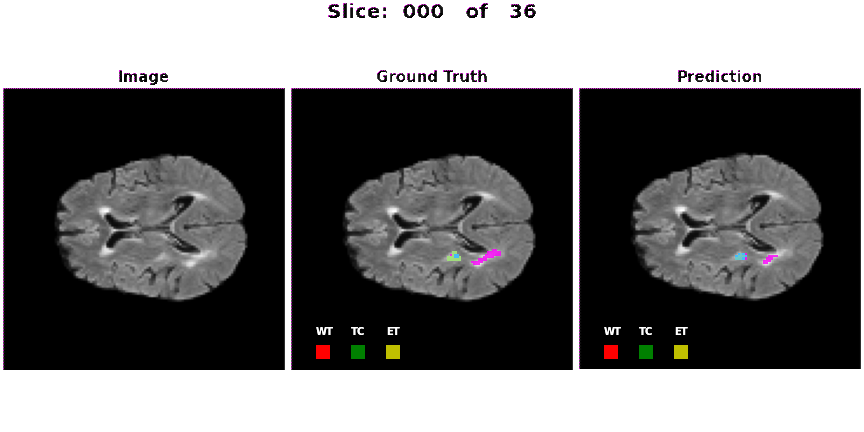

In [82]:
show_gif('image_label_overlay_over_slice.gif', format='png')

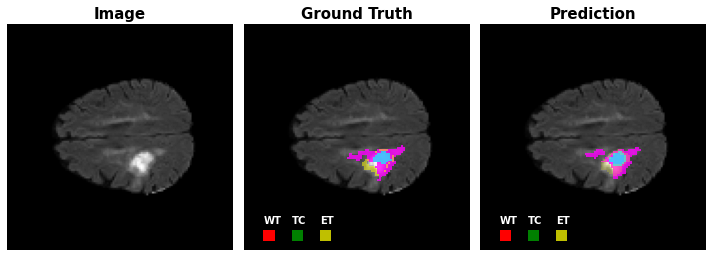

In [83]:
# Set up a loop to generate frames for the animation

fig, axes = plt.subplots(1, 3, figsize = (10, 4))

[ax.axis("off") for ax in axes]
axes[0].set_title("Image", fontsize=15, weight='bold')
axes[0].imshow(img_[:,:,50], cmap ='gray')

axes[1].set_title("Ground Truth", fontsize=15, weight='bold')
axes[1].imshow(img_[:,:,50], cmap ='gray')
axes[1].imshow(np.ma.masked_where(wt[:,:,54] == False, wt[:,:,54]),
  cmap='cool_r', alpha=0.8)
axes[1].imshow(np.ma.masked_where(tc[:,:,54] == False, tc[:,:,54]),
  cmap='cool', alpha=0.7)
axes[1].imshow(np.ma.masked_where(et[:,:,50] == False, et[:,:,50]),
  cmap='autumn_r', alpha=0.5)
axes[1].text(10, 105, 'WT', color='w', fontsize=10, weight='bold')
axes[1].text(25, 105, 'TC', color='w', fontsize=10, weight='bold')
axes[1].text(40, 105, 'ET', color='w', fontsize=10, weight='bold')
# Add rectangles as labels
wt_label = patches.Rectangle((10, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='r')
tc_label = patches.Rectangle((25, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='g')
et_label = patches.Rectangle((40, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='y')

axes[1].add_patch(wt_label)
axes[1].add_patch(tc_label)
axes[1].add_patch(et_label)

axes[2].set_title("Prediction", fontsize=15, weight='bold')
axes[2].imshow(img_[:,:,50], cmap ='gray')
axes[2].imshow(np.ma.masked_where(wt_[:,:,54] == False, wt_[:,:,54]),
  cmap='cool_r', alpha=0.8)
axes[2].imshow(np.ma.masked_where(tc_[:,:,54] == False, tc_[:,:,54]),
  cmap='cool', alpha=0.7)
axes[2].imshow(np.ma.masked_where(et_[:,:,50] == False, et_[:,:,50]),
  cmap='autumn_r', alpha=0.2)
axes[2].text(10, 105, 'WT', color='w', fontsize=10, weight='bold')
axes[2].text(25, 105, 'TC', color='w', fontsize=10, weight='bold')
axes[2].text(40, 105, 'ET', color='w', fontsize=10, weight='bold')
# Add rectangles as labels
wt_label = patches.Rectangle((10, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='r')
tc_label = patches.Rectangle((25, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='g')
et_label = patches.Rectangle((40, 109), 6, 6, linewidth=0, edgecolor='w', facecolor='y')

axes[2].add_patch(wt_label)
axes[2].add_patch(tc_label)
axes[2].add_patch(et_label)
plt.tight_layout()
plt.savefig('Prediction_Pipeline_B.png')
plt.show()


In [84]:
class Image3dToGIF3d:
    """
    Displaying 3D images in 3d axes.
    Parameters:
        img_dim: shape of cube for resizing.
        figsize: figure size for plotting in inches.
    """
    def __init__(self, 
                 img_dim: tuple = (55, 55, 55),
                 figsize: tuple = (15, 10),
                 binary: bool = False,
                 normalizing: bool = True,
                ):
        """Initialization."""
        self.img_dim = img_dim
        print(img_dim)
        self.figsize = figsize
        self.binary = binary
        self.normalizing = normalizing

    def _explode(self, data: np.ndarray):
        """
        Takes: array and return an array twice as large in each dimension,
        with an extra space between each voxel.
        """
        shape_arr = np.array(data.shape)
        size = shape_arr[:3] * 2 - 1
        exploded = np.zeros(np.concatenate([size, shape_arr[3:]]),
                            dtype=data.dtype)
        exploded[::2, ::2, ::2] = data
        return exploded

    def _expand_coordinates(self, indices: np.ndarray):
        x, y, z = indices
        x[1::2, :, :] += 1
        y[:, 1::2, :] += 1
        z[:, :, 1::2] += 1
        return x, y, z
    
    def _normalize(self, arr: np.ndarray):
        """Normilize image value between 0 and 1."""
        arr_min = np.min(arr)
        return (arr - arr_min) / (np.max(arr) - arr_min)

    
    def _scale_by(self, arr: np.ndarray, factor: int):
        """
        Scale 3d Image to factor.
        Parameters:
            arr: 3d image for scalling.
            factor: factor for scalling.
        """
        mean = np.mean(arr)
        return (arr - mean) * factor + mean
    
    def get_transformed_data(self, data: np.ndarray):
        """Data transformation: normalization, scaling, resizing."""
        if self.binary:
            resized_data = resize(data, self.img_dim, preserve_range=True)
            return np.clip(resized_data.astype(np.uint8), 0, 1).astype(np.float32)
            
        norm_data = np.clip(self._normalize(data)-0.1, 0, 1) ** 0.4
        scaled_data = np.clip(self._scale_by(norm_data, 2) - 0.1, 0, 1)
        resized_data = resize(scaled_data, self.img_dim, preserve_range=True)
        
        return resized_data
    
    def plot_cube(self,
                  cube,
                  title: str = '', 
                  init_angle: int = 0,
                  make_gif: bool = False,
                  path_to_save: str = 'filename.gif'
                 ):
        """
        Plot 3d data.
        Parameters:
            cube: 3d data
            title: title for figure.
            init_angle: angle for image plot (from 0-360).
            make_gif: if True create gif from every 5th frames from 3d image plot.
            path_to_save: path to save GIF file.
            """
        if self.binary:
            facecolors = cm.winter(cube)
            print("binary")
        else:
            if self.normalizing:
                cube = self._normalize(cube)
            facecolors = cm.gist_stern(cube)
            print("not binary")
            
        facecolors[:,:,:,-1] = cube
        facecolors = self._explode(facecolors)

        filled = facecolors[:,:,:,-1] != 0
        x, y, z = self._expand_coordinates(np.indices(np.array(filled.shape) + 1))

        with plt.style.context('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle'):

            fig = plt.figure(figsize=self.figsize)
            ax = fig.gca(projection='3d')

            ax.view_init(30, init_angle)
            ax.set_xlim(right = self.img_dim[0] * 2)
            ax.set_ylim(top = self.img_dim[1] * 2)
            ax.set_zlim(top = self.img_dim[2] * 2)
            ax.set_title(title, fontsize=18, y=1.05)

            ax.voxels(x, y, z, filled, facecolors=facecolors, shade=False)

            if make_gif:
                images = []
                for angle in tqdm(range(0, 360, 5)):
                    ax.view_init(30, angle)
                    fname = 'figures/' + str(angle) + '.png'

                    plt.savefig(fname, dpi=120, format='png', bbox_inches='tight')
                    images.append(imageio.imread(fname))
                    #os.remove(fname)
                imageio.mimsave(path_to_save, images)
                plt.close()

            else:
                plt.show()


(120, 120, 78)
binary


100%|██████████| 72/72 [12:15<00:00, 10.21s/it]


CPU times: user 16min 40s, sys: 16.2 s, total: 16min 56s
Wall time: 16min 38s


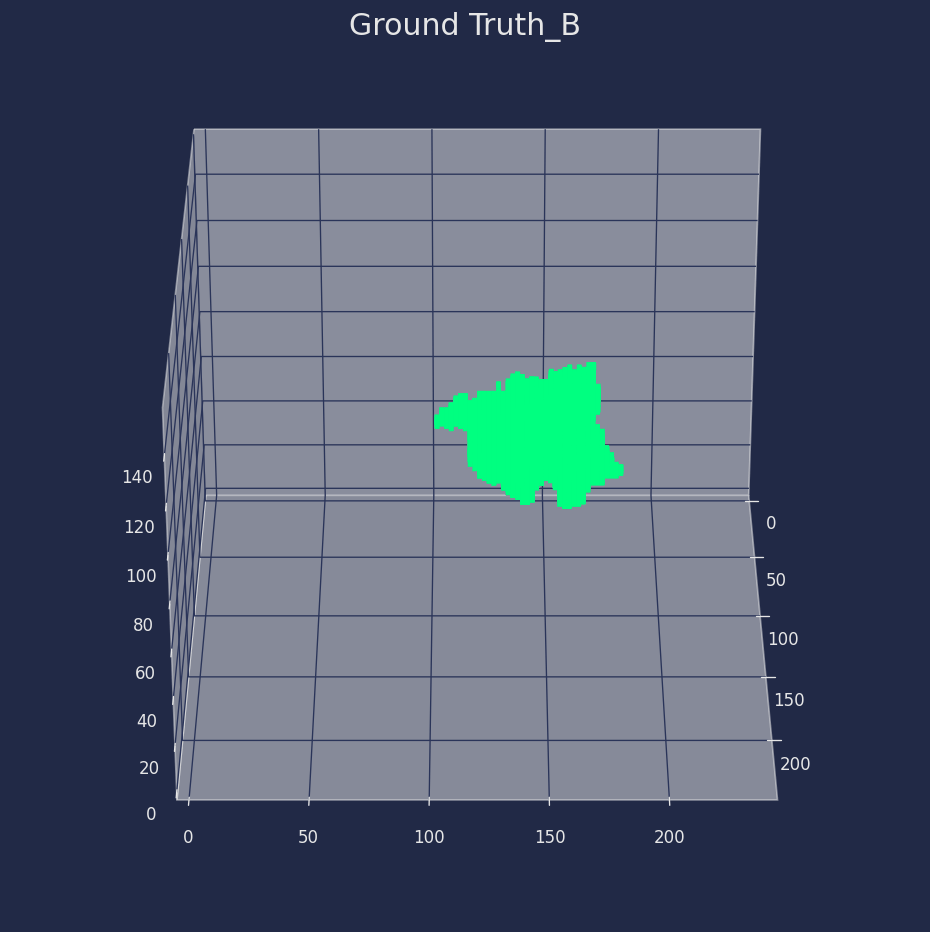

In [85]:
%%time
title = "Ground Truth_" + id_[0]
filename1 = title + "_3d.gif"

data_to_3dgif = Image3dToGIF3d(img_dim = (120, 120, 78), binary=True, normalizing=False)
transformed_data = data_to_3dgif.get_transformed_data(gt)
data_to_3dgif.plot_cube(
    transformed_data,
    title=title,
    make_gif=True,
    path_to_save=filename1
)
show_gif(filename1, format='png')

(120, 120, 78)
binary


100%|██████████| 72/72 [10:01<00:00,  8.35s/it]


CPU times: user 14min 30s, sys: 15.4 s, total: 14min 46s
Wall time: 14min 28s


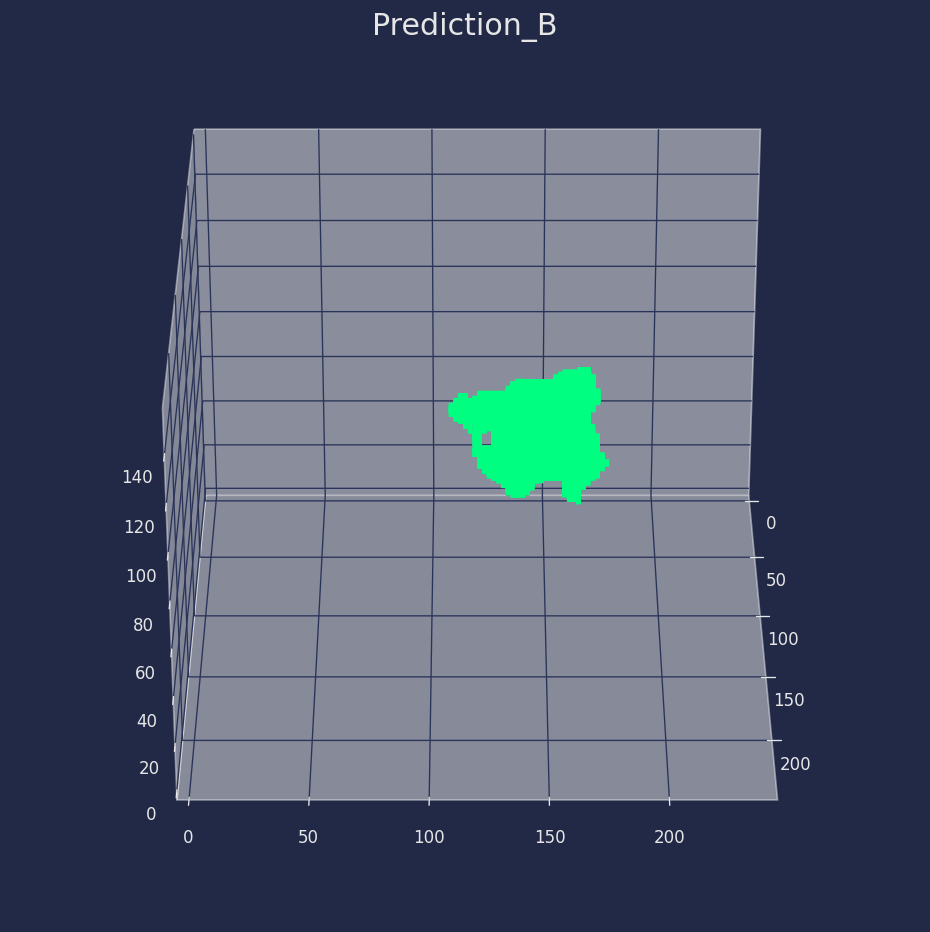

In [86]:
%%time
title = "Prediction_" + id_[0]
filename2 = title + "_3d.gif"

data_to_3dgif = Image3dToGIF3d(img_dim = (120, 120, 78), binary=True, normalizing=False)
transformed_data = data_to_3dgif.get_transformed_data(prediction)
data_to_3dgif.plot_cube(
    transformed_data,
    title=title,
    make_gif=True,
    path_to_save=filename2
)
show_gif(filename2, format='png')

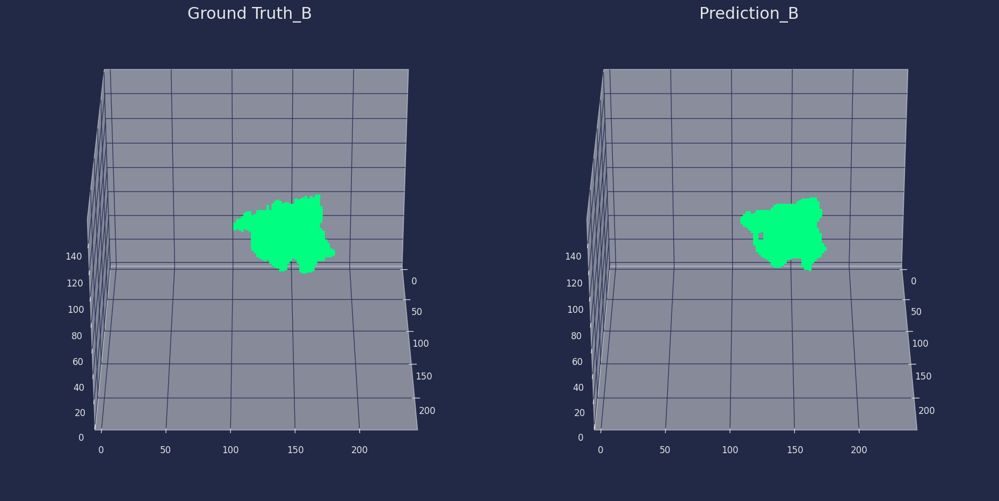

In [87]:

merging_two_gif(filename1,
                filename2, 
                'result.gif')
show_gif('result.gif', format='png')
